In [ ]:
import os
import matplotlib.pyplot as plt
import re
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
import plotly.express as px
import matplotlib.pyplot as plt
import xml.etree.ElementTree as xet
from glob import glob
from skimage import io
from shutil import copy
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten, Input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import re

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
def listpath(path):
    path1=os.listdir(path)
    path1.sort()
    a = [path+name for name in path1 if name.endswith(".xml")]
    labels_dict = dict(filepath=[],xmin=[],xmax=[],ymin=[],ymax=[])
    for filename in a:
        info = xet.parse(filename)
        root = info.getroot()
        member_object = root.find('object')
        labels_info = member_object.find('bndbox')
        xmin = int(labels_info.find('xmin').text)
        xmax = int(labels_info.find('xmax').text)
        ymin = int(labels_info.find('ymin').text)
        ymax = int(labels_info.find('ymax').text)

        labels_dict['filepath'].append(filename)
        labels_dict['xmin'].append(xmin)
        labels_dict['xmax'].append(xmax)
        labels_dict['ymin'].append(ymin)
        labels_dict['ymax'].append(ymax)
    return labels_dict
train_path='/content/drive/MyDrive/container_dataset/train_xml/'
val_path='/content/drive/MyDrive/container_dataset/val_xml/'
train_label=listpath(train_path)
val_label=listpath(val_path)

In [ ]:
df_train=pd.DataFrame(train_label)
df_val=pd.DataFrame(val_label)
df_train.to_csv('train.csv',index=False)
df_val.to_csv('val.csv',index=False)
display(df_train.head())
display(df_val.head())

,filepath,xmin,xmax,ymin,ymax
0,/content/drive/MyDrive/container_dataset/train...,814,998,33,122
1,/content/drive/MyDrive/container_dataset/train...,779,1001,67,176
2,/content/drive/MyDrive/container_dataset/train...,770,1003,79,191
3,/content/drive/MyDrive/container_dataset/train...,781,995,60,170
4,/content/drive/MyDrive/container_dataset/train...,810,976,11,97


,filepath,xmin,xmax,ymin,ymax
0,/content/drive/MyDrive/container_dataset/val_x...,832,1042,26,101
1,/content/drive/MyDrive/container_dataset/val_x...,831,1085,74,160
2,/content/drive/MyDrive/container_dataset/val_x...,763,1048,77,173
3,/content/drive/MyDrive/container_dataset/val_x...,778,1013,32,111
4,/content/drive/MyDrive/container_dataset/val_x...,819,1032,14,89


In [ ]:
def getFilename(filename):
    filename_image=xet.parse(filename).getroot().find('filename').text
    filepath_image=os.path.join('/content/drive/MyDrive/container_dataset/',path_attr+'/'+filename_image)
    return filepath_image

In [ ]:
path_attr='train'
image_path=list(df_train['filepath'].apply(getFilename))
print(image_path[:10])
path_attr='val'
image_path1=list(df_val['filepath'].apply(getFilename))
print(image_path[:10])

['/content/drive/MyDrive/container_dataset/train/image_0001.jpg', '/content/drive/MyDrive/container_dataset/train/image_0002.jpg', '/content/drive/MyDrive/container_dataset/train/image_0003.jpg', '/content/drive/MyDrive/container_dataset/train/image_0004.jpg', '/content/drive/MyDrive/container_dataset/train/image_0005.jpg', '/content/drive/MyDrive/container_dataset/train/image_0006.jpg', '/content/drive/MyDrive/container_dataset/train/image_0007.jpg', '/content/drive/MyDrive/container_dataset/train/image_0008.jpg', '/content/drive/MyDrive/container_dataset/train/image_0009.jpg', '/content/drive/MyDrive/container_dataset/train/image_0010.jpg']
['/content/drive/MyDrive/container_dataset/train/image_0001.jpg', '/content/drive/MyDrive/container_dataset/train/image_0002.jpg', '/content/drive/MyDrive/container_dataset/train/image_0003.jpg', '/content/drive/MyDrive/container_dataset/train/image_0004.jpg', '/content/drive/MyDrive/container_dataset/train/image_0005.jpg', '/content/drive/MyDrive


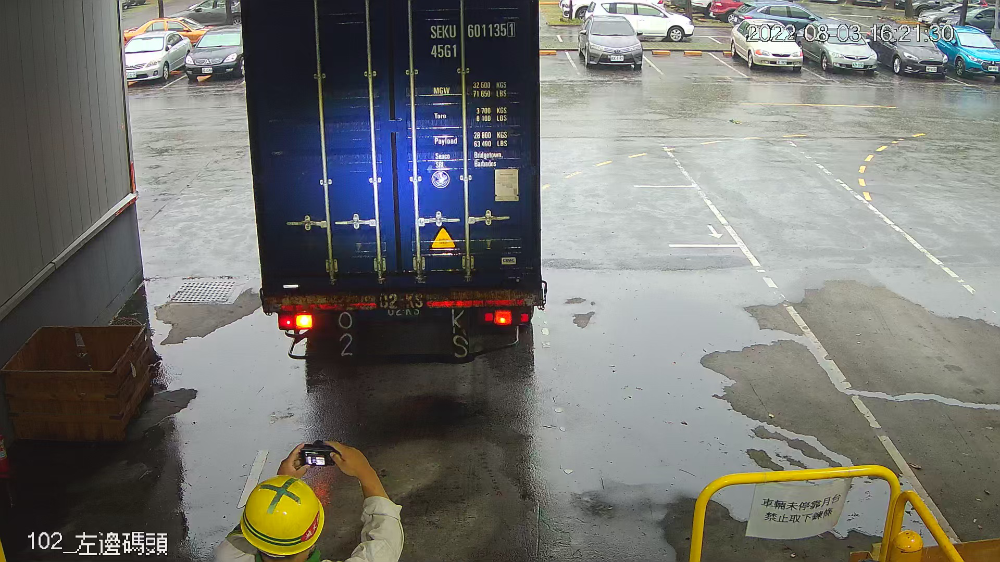

In [ ]:
# file_path=image_path[87]
file_path='/content/drive/MyDrive/container_dataset/train/image_0001.jpg'
img=cv2.imread(file_path)
img=io.imread(file_path)
fig=px.imshow(img)
fig.update_layout(width=600,height=600, margin=dict(l=10, r=10, b=10, t=10))#更新圖形的布局，margin參數指定了圖形的邊距，包括左邊距(I)，右邊距(R)，下邊距(B)和上邊距(T)
fig.add_shape(type='rect',x0=819, x1=998, y0=33, y1=122, xref='x', yref='y',line_color='cyan')

In [ ]:
# roi = img[33:122,819:998]
# text = pt.image_to_string(roi)
# print(text)

In [ ]:
#Targeting all our values in array selecting all columns
def data_output(labels,image_path):
    data = []
    output = []
    for i in range(len(image_path)):
        image = image_path[i]#得到檔案路徑
        print(image)
        img_arr = cv2.imread(image)#讀取圖片
    #     print(img_arr)
        h,w,d = img_arr.shape#得到檔案大小，拿來給之後的做正規化
        # Prepprocesing
        load_image = load_img(image,target_size=(224,224))
        load_image_arr = img_to_array(load_image)
        norm_load_image_arr = load_image_arr/255.0 # Normalization
        # Normalization to labels
        xmin,xmax,ymin,ymax = labels[i]
        nxmin,nxmax = xmin/w,xmax/w
        nymin,nymax = ymin/h,ymax/h
        label_norm = (nxmin,nxmax,nymin,nymax) # Normalized output
        # Append
        data.append(norm_load_image_arr)
        output.append(label_norm)
    return data,output

In [ ]:
labels = df_train.iloc[:,1:].values
train_data,train_label=data_output(labels,image_path)
labels = df_val.iloc[:,1:].values
val_data,val_label=data_output(labels,image_path1)

/content/drive/MyDrive/container_dataset/train/image_0001.jpg
/content/drive/MyDrive/container_dataset/train/image_0002.jpg
/content/drive/MyDrive/container_dataset/train/image_0003.jpg
/content/drive/MyDrive/container_dataset/train/image_0004.jpg
/content/drive/MyDrive/container_dataset/train/image_0005.jpg
/content/drive/MyDrive/container_dataset/train/image_0006.jpg
/content/drive/MyDrive/container_dataset/train/image_0007.jpg
/content/drive/MyDrive/container_dataset/train/image_0008.jpg
/content/drive/MyDrive/container_dataset/train/image_0009.jpg
/content/drive/MyDrive/container_dataset/train/image_0010.jpg
/content/drive/MyDrive/container_dataset/train/image_0011.jpg
/content/drive/MyDrive/container_dataset/train/image_0012.jpg
/content/drive/MyDrive/container_dataset/train/image_0013.jpg
/content/drive/MyDrive/container_dataset/train/image_0014.jpg
/content/drive/MyDrive/container_dataset/train/image_0015.jpg
/content/drive/MyDrive/container_dataset/train/image_0016.jpg
/content

In [ ]:
train=np.array(train_data,dtype=np.float32)
train_output=np.array(train_label,dtype=np.float32)
val=np.array(val_data,dtype=np.float32)
val_output=np.array(val_label,dtype=np.float32)

In [ ]:
train

array([[[[0.22352941, 0.22745098, 0.20784314],
         [0.21960784, 0.22352941, 0.20392157],
         [0.22745098, 0.23137255, 0.21176471],
         ...,
         [0.3254902 , 0.3254902 , 0.31764707],
         [0.32941177, 0.3372549 , 0.33333334],
         [0.6039216 , 0.6117647 , 0.5921569 ]],

        [[0.22745098, 0.23137255, 0.21176471],
         [0.22352941, 0.22745098, 0.20784314],
         [0.23137255, 0.23529412, 0.21568628],
         ...,
         [0.7176471 , 0.75686276, 0.7529412 ],
         [0.39607844, 0.4       , 0.38039216],
         [0.44705883, 0.45490196, 0.44313726]],

        [[0.23137255, 0.23529412, 0.21568628],
         [0.23137255, 0.23529412, 0.21568628],
         [0.23529412, 0.23921569, 0.21960784],
         ...,
         [0.54509807, 0.56078434, 0.59607846],
         [0.5019608 , 0.5137255 , 0.5411765 ],
         [0.63529414, 0.6431373 , 0.6313726 ]],

        ...,

        [[0.5686275 , 0.46666667, 0.        ],
         [0.08235294, 0.09019608, 0.04705882]

In [ ]:
print(train.shape,train_output.shape)
print(val.shape,val_output.shape)

(2125, 224, 224, 3) (2125, 4)
(536, 224, 224, 3) (536, 4)


In [ ]:
# parsing
def parsing(path):
    parser = xet.parse(path).getroot()
    name = parser.find('filename').text
    filename = f'/content/drive/MyDrive/container_dataset/train/{name}'

    # width and height
    parser_size = parser.find('size')
    width = int(parser_size.find('width').text)
    height = int(parser_size.find('height').text)
    
    return filename, width, height
df_train[['filename','width','height']] = df_train['filepath'].apply(parsing).apply(pd.Series)
display(df_train.head())
df_val[['filename','width','height']] = df_val['filepath'].apply(parsing).apply(pd.Series)
display(df_val.head())

,filepath,xmin,xmax,ymin,ymax,filename,width,height
0,/content/drive/MyDrive/container_dataset/train...,814,998,33,122,/content/drive/MyDrive/container_dataset/train...,1920,1080
1,/content/drive/MyDrive/container_dataset/train...,779,1001,67,176,/content/drive/MyDrive/container_dataset/train...,1920,1080
2,/content/drive/MyDrive/container_dataset/train...,770,1003,79,191,/content/drive/MyDrive/container_dataset/train...,1920,1080
3,/content/drive/MyDrive/container_dataset/train...,781,995,60,170,/content/drive/MyDrive/container_dataset/train...,1920,1080
4,/content/drive/MyDrive/container_dataset/train...,810,976,11,97,/content/drive/MyDrive/container_dataset/train...,1920,1080


,filepath,xmin,xmax,ymin,ymax,filename,width,height
0,/content/drive/MyDrive/container_dataset/val_x...,832,1042,26,101,/content/drive/MyDrive/container_dataset/train...,1920,1080
1,/content/drive/MyDrive/container_dataset/val_x...,831,1085,74,160,/content/drive/MyDrive/container_dataset/train...,1920,1080
2,/content/drive/MyDrive/container_dataset/val_x...,763,1048,77,173,/content/drive/MyDrive/container_dataset/train...,1920,1080
3,/content/drive/MyDrive/container_dataset/val_x...,778,1013,32,111,/content/drive/MyDrive/container_dataset/train...,1920,1080
4,/content/drive/MyDrive/container_dataset/val_x...,819,1032,14,89,/content/drive/MyDrive/container_dataset/train...,1920,1080


In [ ]:
# center_x, center_y, width , height
df_train['center_x'] = (df_train['xmax'] + df_train['xmin'])/(2*df_train['width'])
df_train['center_y'] = (df_train['ymax'] + df_train['ymin'])/(2*df_train['height'])

df_train['bb_width'] = (df_train['xmax'] - df_train['xmin'])/df_train['width']
df_train['bb_height'] = (df_train['ymax'] - df_train['ymin'])/df_train['height']
df_train.head()

,filepath,xmin,xmax,ymin,ymax,filename,width,height,center_x,center_y,bb_width,bb_height
0,/content/drive/MyDrive/container_dataset/train...,814,998,33,122,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.471875,0.071759,0.095833,0.082407
1,/content/drive/MyDrive/container_dataset/train...,779,1001,67,176,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.463542,0.112500,0.115625,0.100926
2,/content/drive/MyDrive/container_dataset/train...,770,1003,79,191,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.461719,0.125000,0.121354,0.103704
3,/content/drive/MyDrive/container_dataset/train...,781,995,60,170,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.462500,0.106481,0.111458,0.101852
4,/content/drive/MyDrive/container_dataset/train...,810,976,11,97,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.465104,0.050000,0.086458,0.079630


In [ ]:
df_val['center_x'] = (df_val['xmax'] + df_val['xmin'])/(2*df_val['width'])
df_val['center_y'] = (df_val['ymax'] + df_val['ymin'])/(2*df_val['height'])

df_val['bb_width'] = (df_val['xmax'] - df_val['xmin'])/df_val['width']
df_val['bb_height'] = (df_val['ymax'] - df_val['ymin'])/df_val['height']
df_val.head()

,filepath,xmin,xmax,ymin,ymax,filename,width,height,center_x,center_y,bb_width,bb_height
0,/content/drive/MyDrive/container_dataset/val_x...,832,1042,26,101,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.488021,0.058796,0.109375,0.069444
1,/content/drive/MyDrive/container_dataset/val_x...,831,1085,74,160,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.498958,0.108333,0.132292,0.079630
2,/content/drive/MyDrive/container_dataset/val_x...,763,1048,77,173,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.471615,0.115741,0.148438,0.088889
3,/content/drive/MyDrive/container_dataset/val_x...,778,1013,32,111,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.466406,0.066204,0.122396,0.073148
4,/content/drive/MyDrive/container_dataset/val_x...,819,1032,14,89,/content/drive/MyDrive/container_dataset/train...,1920,1080,0.482031,0.047685,0.110937,0.069444


In [ ]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 15836, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 15836 (delta 0), reused 4 (delta 0), pack-reused 15831
Receiving objects: 100% (15836/15836), 14.42 MiB | 32.04 MiB/s, done.
Resolving deltas: 100% (10874/10874), done.


In [ ]:
!pip install -r ./yolov5/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 592.5/592.5 kB 24.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.9 MB/s eta 0:00:00


In [ ]:
mkdir /content/yolov5/data_images/

In [ ]:
mkdir /content/yolov5/data_images/test

In [ ]:
mkdir /content/yolov5/data_images/train

In [ ]:
mkdir /content/yolov5/data_images/val

In [ ]:
train_folder = '/content/yolov5/data_images/train'

values = df_train[['filename','center_x','center_y','bb_width','bb_height']].values
for fname, x,y, w, h in values:
    image_name = os.path.split(fname)[-1]
    txt_name = os.path.splitext(image_name)[0]
    
    dst_image_path = os.path.join(train_folder,image_name)
    dst_label_file = os.path.join(train_folder,txt_name+'.txt')
    
    # copy each image into the folder
    copy(fname,dst_image_path)

    # generate .txt which has label info
    label_txt = f'0 {x} {y} {w} {h}'
    with open(dst_label_file,mode='w') as f:
        f.write(label_txt)
        
        f.close()

val_folder = '/content/yolov5/data_images/val'

values = df_val[['filename','center_x','center_y','bb_width','bb_height']].values
for fname, x,y, w, h in values:
    image_name = os.path.split(fname)[-1]
    txt_name = os.path.splitext(image_name)[0]
    
    dst_image_path = os.path.join(val_folder,image_name)
    dst_label_file = os.path.join(val_folder,txt_name+'.txt')
    
    # copy each image into the folder
    copy(fname,dst_image_path)

    # generate .txt which has label info
    label_txt = f'0 {x} {y} {w} {h}'
    with open(dst_label_file,mode='w') as f:
        f.write(label_txt)
        
        f.close()

In [ ]:
test_folder = '/content/yolov5/data_images/test'
test_path='/content/drive/MyDrive/container_dataset/test/'
path1=os.listdir(test_path)
path1.sort()

for fname in path1:
    dst_image_path = os.path.join(test_folder,fname)
    # copy each image into the folder
    copy(test_path+fname,dst_image_path)

In [ ]:
# Create .yaml file 
import yaml

data_yaml = dict(
    train = 'data_images/train',
    val = 'data_images/val',
    nc = 1,
    names = ['Container']
)

# Note that I am creating the file in the yolov5/data/ directory.
with open('/content/yolov5/data_images/data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

In [ ]:
!pip install GPUtil

import torch
from GPUtil import showUtilization as gpu_usage
from numba import cuda

def free_gpu_cache():
    print("Initial GPU Usage")
    gpu_usage()                             

    torch.cuda.empty_cache()

    cuda.select_device(0)
    cuda.close()
    cuda.select_device(0)

    print("GPU Usage after emptying the cache")
    gpu_usage()

free_gpu_cache()  

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for GPUtil: filename=GPUtil-1.4.0-py3-none-any.whl size=7393 sha256=f8368dd661398af6fdfea6f3b54f1e4a68be155d52f45f550ae1a88e8b72a96e
  Stored in directory: /root/.cache/pip/wheels/a9/8a/bd/81082387151853ab8b6b3ef33426e98f5cbfebc3c397a9d4d0
Successfully built GPUtil
Initial GPU Usage
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |
GPU Usage after emptying the cache
| ID | GPU | MEM |
------------------
|  0 |  5% |  1% |


In [ ]:
!python ./yolov5/train.py --data /content/yolov5/data_images/data.yaml --cfg ./yolov5/models/yolov5s.yaml --batch-size 8 --name Model --epochs 20

train: weights=yolov5/yolov5s.pt, cfg=./yolov5/models/yolov5s.yaml, data=/content/yolov5/data_images/data.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=20, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=Model, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-173-g5733342 Python-3.10.11 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0

In [ ]:
!python ./yolov5/detect.py --source /content/yolov5/data_images/test/ --weights ./yolov5/runs/train/Model/weights/best.pt

detect: weights=['./yolov5/runs/train/Model/weights/best.pt'], source=/content/yolov5/data_images/test/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-173-g5733342 Python-3.10.11 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/755 /content/yolov5/data_images/test/image_0001.jpg: 384x640 1 Container, 68.0ms
image 2/755 /content/yolov5/data_images/test/image_0002.jpg: 384x640 1 Container, 10.0ms
image 3/755 /content/yolov5/data_images/test/image_0003.jpg: 384x640 1 Container, 7.9ms
image 4/755 /content/yolov5/data_images

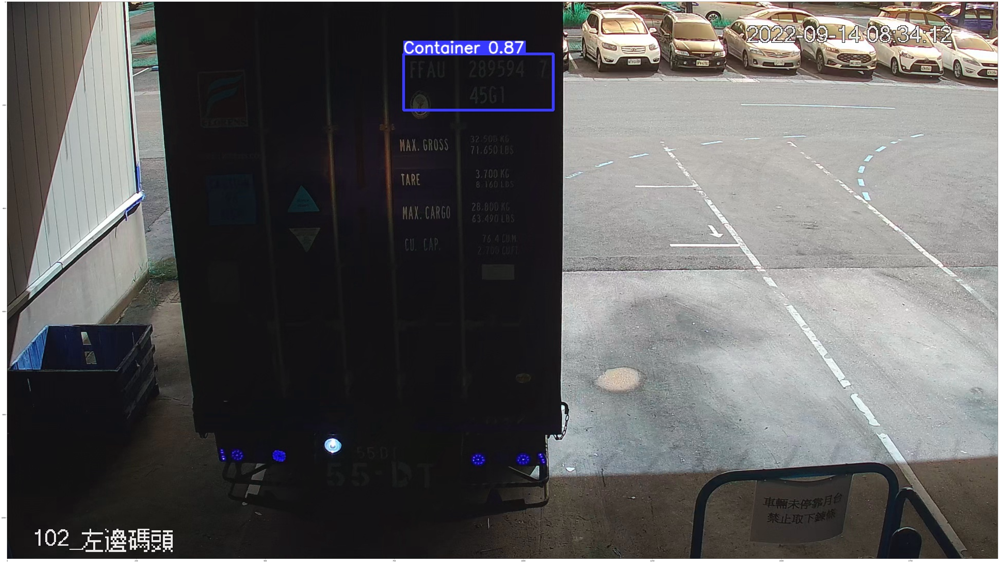

In [ ]:
img = cv2.imread("/content/yolov5/runs/detect/exp/image_0058.jpg")
plt.figure(figsize=(100, 100))
plt.imshow(img)

In [ ]:
!python ./yolov5/export.py --weight ./yolov5/runs/train/Model/weights/best.pt --include torchscript onnx

export: data=yolov5/data/coco128.yaml, weights=['./yolov5/runs/train/Model/weights/best.pt'], imgsz=[640, 640], batch_size=1, device=cpu, half=False, inplace=False, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=17, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['torchscript', 'onnx']
YOLOv5 🚀 v7.0-173-g5733342 Python-3.10.11 torch-2.0.1+cu118 CPU

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs

PyTorch: starting from yolov5/runs/train/Model/weights/best.pt with output shape (1, 25200, 6) (13.7 MB)

TorchScript: starting export with torch 2.0.1+cu118...
TorchScript: export success ✅ 2.6s, saved as yolov5/runs/train/Model/weights/best.torchscript (27.2 MB)

ONNX: starting export with onnx 1.14.0...
============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
=========

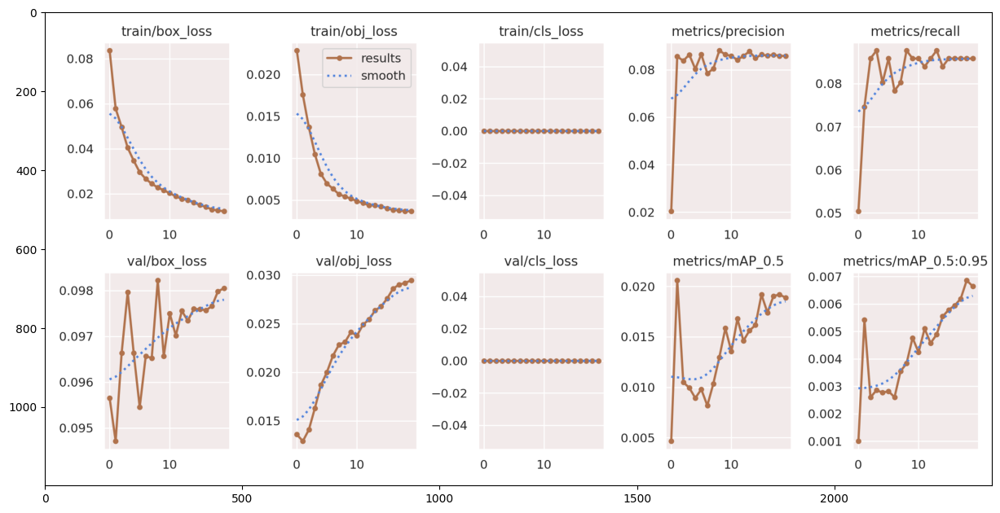

In [ ]:
img = cv2.imread("/content/yolov5/runs/train/Model/results.png")
plt.figure(figsize=(15, 15))
plt.imshow(img)

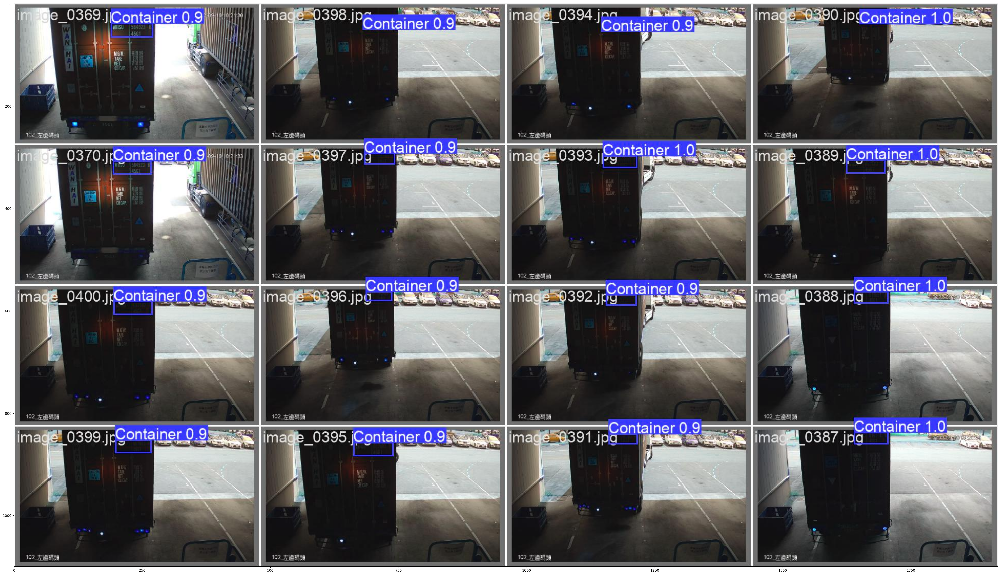

In [ ]:
img = cv2.imread("/content/yolov5/runs/train/Model/val_batch2_pred.jpg")
plt.figure(figsize=(50, 50))
plt.imshow(img)

In [ ]:
# settings
INPUT_WIDTH =  640
INPUT_HEIGHT = 640

In [ ]:
# LOAD YOLO MODEL
net = cv2.dnn.readNetFromONNX('./yolov5/runs/train/Model/weights/best.onnx')
net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

In [ ]:
def get_detections(img,net):
    # 1.CONVERT IMAGE TO YOLO FORMAT
    image = img.copy()
    row, col, d = image.shape

    max_rc = max(row,col)
    input_image = np.zeros((max_rc,max_rc,3),dtype=np.uint8)
    input_image[0:row,0:col] = image

    # 2. GET PREDICTION FROM YOLO MODEL
    blob = cv2.dnn.blobFromImage(input_image,1/255,(INPUT_WIDTH,INPUT_HEIGHT),swapRB=True,crop=False)
    net.setInput(blob)
    preds = net.forward()
    detections = preds[0]
    
    return input_image, detections

def non_maximum_supression(input_image,detections):
    
    # 3. FILTER DETECTIONS BASED ON CONFIDENCE AND PROBABILIY SCORE
    
    # center x, center y, w , h, conf, proba
    boxes = []
    confidences = []

    image_w, image_h = input_image.shape[:2]
    x_factor = image_w/INPUT_WIDTH
    y_factor = image_h/INPUT_HEIGHT

    for i in range(len(detections)):
        row = detections[i]
        confidence = row[4] # confidence of detecting license plate
        if confidence > 0.4:
            class_score = row[5] # probability score of license plate
            if class_score > 0.25:
                cx, cy , w, h = row[0:4]

                left = int((cx - 0.5*w)*x_factor)
                top = int((cy-0.5*h)*y_factor)
                width = int(w*x_factor)
                height = int(h*y_factor)
                box = np.array([left,top,width,height])

                confidences.append(confidence)
                boxes.append(box)

    # 4.1 CLEAN
    boxes_np = np.array(boxes).tolist()
    confidences_np = np.array(confidences).tolist()
    
    # 4.2 NMS
    index = cv2.dnn.NMSBoxes(boxes_np,confidences_np,0.25,0.45)
    
    return boxes_np, confidences_np, index

def drawings(image,boxes_np,confidences_np,index,image_path=''):
    # 5. Drawings
    for ind in index:
        x,y,w,h =  boxes_np[ind]
        bb_conf = confidences_np[ind]
        conf_text = 'container: {:.0f}%'.format(bb_conf*100)
        if(image_path==''):
          license_text = extract_text(image,boxes_np[ind])
        else:
          license_text = extract_text(image_path,boxes_np[ind])


        cv2.rectangle(image,(x,y),(x+w,y+h),(255,0,255),2)
        cv2.rectangle(image,(x,y-30),(x+w,y),(255,0,255),-1)
        cv2.rectangle(image,(x,y+h),(x+w,y+h+25),(0,0,0),-1)


        cv2.putText(image,conf_text,(x,y-10),cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),3)
        cv2.putText(image,license_text,(x,y+h+27),cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),3)

    return image

In [ ]:
# predictions flow with return result
def yolo_predictions(img,net,image_path=''):
    # step-1: detections
    input_image, detections = get_detections(img,net)
    # step-2: NMS
    boxes_np, confidences_np, index = non_maximum_supression(input_image, detections)
    # step-3: Drawings
    if(image_path==''):
      result_img = drawings(img,boxes_np,confidences_np,index,image_path)  
    else:
      result_img = drawings(img,boxes_np,confidences_np,index)  
    return result_img

In [ ]:
def calculate_formula_result(letters):
                        values = {
                                    'A': 10, 'B': 12, 'C': 13, 'D': 14, 'E': 15, 'F': 16, 'G': 17, 'H': 18, 'I': 19, 'J': 20,
                                    'K': 21, 'L': 23, 'M': 24, 'N': 25, 'O': 26, 'P': 27, 'Q': 28, 'R': 29, 'S': 30, 'T': 31,
                                    'U': 32, 'V': 34, 'W': 35, 'X': 36, 'Y': 37, 'Z': 38, 'a': 10, 'b': 12, 'c': 13, 'd': 14, 'e': 15, 'f': 16, 'g': 17, 'h': 18, 'i': 19, 'j': 20,
                                    'k': 21, 'l': 23, 'm': 24, 'n': 25, 'o': 26, 'p': 27, 'q': 28, 'r': 29, 's': 30, 't': 31,
                                    'u': 32, 'v': 34, 'w': 35, 'x': 36, 'y': 37, 'z': 38,'1': 1,  '2':  2,'3':3,'4':4,'5':5,'6':6,'7':7,'8':8,'9':9
                                }
                        total = 0
                        for i, letter in enumerate(letters):
                            if letter in values:
                                total += values[letter] * (2 ** i)
                        if(total % 11)==10:
                          total=0
                        else:
                          total=total%11
                        return total   

In [ ]:
def image_enhance(image,bbox):
    x,y,w,h = bbox
    # 打开图像
    if(type(image)==str):
      image = Image.open(image)
    else:
      image=Image.fromarray(image)
    roi=image.crop((x, y, x+w, y+h))
    # 创建图像增强对象
    enhancer = ImageEnhance.Brightness(roi)
    # 增强亮度
    brightened_image = enhancer.enhance(0.5)  # 参数为增强倍数

    contrast = ImageEnhance.Contrast(brightened_image)# 調整對比  
    output_c5 = contrast.enhance(5)# 提高對比 

    color = ImageEnhance.Color(output_c5)# 調整飽和度
    output_color5 = color.enhance(0)# 提高飽和度
    return output_color5#得到新圖片

In [ ]:
def is_array(obj):
    return isinstance(obj, np.ndarray)

In [ ]:
from PIL import ImageEnhance
from PIL import Image
from numpy import asarray
store_num=[]
store_video=[]
isvideo=False
def extract_text(image,bbox):
    s=''
    # 打开图像
    if(type(is_array(image))):
      isvideo=True
    img=image_enhance(image,bbox)
    img2 = img.convert('L') # convert to L (Grayscale)
    img2=asarray(img2)
    kernel3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    #閉運算
    dilationimage2 = cv2.morphologyEx(img2, cv2.MORPH_CLOSE, kernel3)

    # 執行平均濾波
    kernel_size = (2, 2)  # 濾波器的大小
    smoothed_image = cv2.blur(dilationimage2, kernel_size)

    # 將 NumPy 陣列轉換為 PIL 形式的圖像
    pil_image = Image.fromarray(smoothed_image)

    sharpness = ImageEnhance.Sharpness(pil_image)# 調整銳利度
    output_s15 = sharpness.enhance(4)# 提高銳利度
    output_s15=asarray(output_s15)
    if 0 in output_s15.shape:
        return 'no number'
    else:
        result = reader.readtext(output_s15)
        for i in range(len(result)):
          s=s+result[i][1]
        # 使用正则表达式模式匹配非数字和非英文字母字符
        pattern = r'[^a-zA-Z0-9]'
        clean_s = re.sub(pattern, '', s)
        num=clean_s[:10]
        result = calculate_formula_result(num)
        print('result:',num+str(result))
        store_num.append(num+str(result))
        if(isvideo):
          store_video.append(num+str(result))
        return num+str(result)

In [ ]:
!pip install easyocr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 813.9/813.9 kB 62.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.0/146.0 kB 21.1 MB/s eta 0:00:00


In [ ]:
import easyocr
# test
reader = easyocr.Reader(['en'])

In [ ]:
path='/content/drive/MyDrive/newtest/'
path1=os.listdir(path)
path1.sort()
aaa=0
for i in range(len(path1)):
  img = io.imread(path+path1[i])
  image_path=path+path1[i]
  results = yolo_predictions(img,net,image_path)
  split_path=path1[i].split('.')
  # print(split_path[0])
  if(store_num[i]==split_path[0]):
    aaa=aaa+1
# print(aaa)
print('準確率為:',(aaa/len(path1)))

result: FFAU2095944
result: MAGU5605323
result: SEKU5875349
result: SEKU5877491
result: SEKU6026686
result: TCNU6246126
result: TLLU4080736
result: TRHU8927462
result: TSSU5017340
result: TSSU5029819
result: TSSU5042071
result: TSSU5061615
result: TSSU5099400
result: TSSU5142300
result: TSSU5160351
result: WHLU5591798
result: WHLU5842825
result: BeHd17217
result: WHSU2615314
result: WHSU1286472
result: WHSU5295430
result: WHSU5368199
result: WHSU5563298
result: WHSU5610492
result: WHSU5628589
result: WHSU5744465
result: WHSU1599116
result: WHSU5990392
result: WHSU6010260
result: WHSU6040178
result: WHSU6052306
result: WHSU6167120
result: WHSU0557380
result: WHSU6651665
result: WHSU6856285
準確率為: 0.8285714285714286



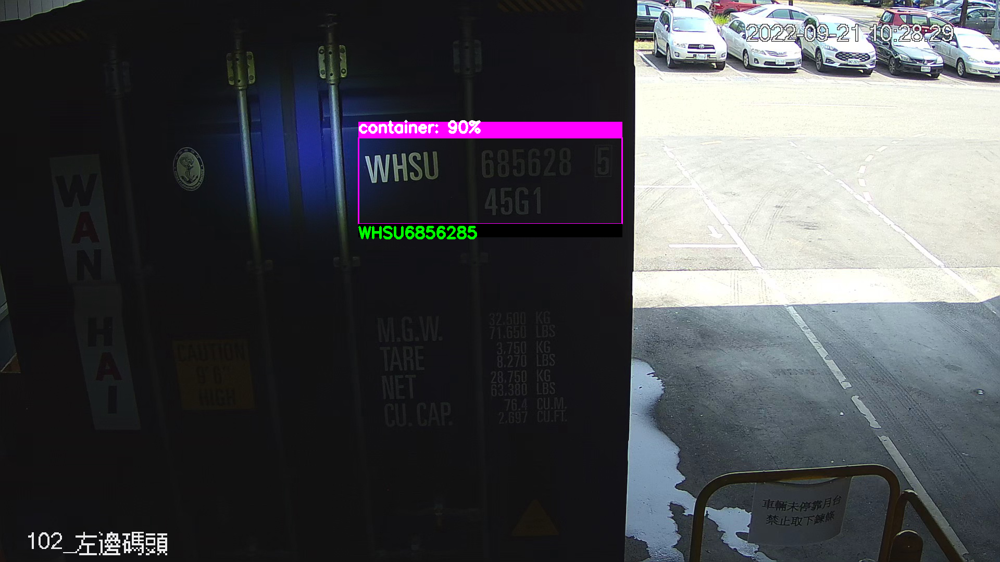

In [ ]:
fig = px.imshow(img)
fig.update_layout(width=1000, height=800, margin=dict(l=10, r=10, b=10, t=10))
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
fig.show()

In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫


v_in = '/content/drive/MyDrive/container_movie/video_0001.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0001.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0001.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0001.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0001.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

result: SEkku58a447
result: SEKU547aJ40
result: SEXU6070343
result: SEkU60734U3
result: SKU6876J4U8
result: SKU6X76J4V6
result: ScKU6876346
result: Scku6X76Ja0
result: Sckku687633
result: ScKU6876346
result: SEKU6976J45
result: SEKU6976349
result: SEKU6076347
result: SEKU6076347
result: SEKU6075340
result: SEKU6875343
result: SEKU6876340
result: SEXU6875348
result: SEKU6175340
result: SEKU6075340
result: SekU6875343
result: SEKU6875343
result: SEKU6875343
result: SeKU5075346
result: SEKU6076347
result: SEKU5075346
result: SCKU6075347
result: SEKU6875390
result: SEKU6875343
result: SEKU5875349
result: SEKU5076342
result: SEKU6075340
result: SEKU5075346
result: SEKU6075340
result: SEKU6075340
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5075346
result: SEKU5875349
result: SEKU5875349
result: SEKU5875349
result: SEKU5875349
result: SEKU5875349
result: SEKU5875349


In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: SEKU5875349


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0002.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0002.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0002.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0002.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0002.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: TSSU5099400


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0003.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0003.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0003.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0003.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0003.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: 45612


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0004.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0004.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0004.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0004.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0004.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: WHSU6728690


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0005.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0005.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0005.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0005.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0005.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: WHSU5368199


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0006.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0006.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0006.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0006.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0006.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0007.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0007.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0007.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0007.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0007.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: WHSU6167120


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0008.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0008.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0008.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0008.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0008.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: WHSU6892256


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0009.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0009.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0009.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0009.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0009.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: WIISU522370


In [ ]:
from IPython.display import HTML # 導入IPython.display HTML函式庫
from base64 import b64encode # 導入base64 baseencode函式庫
import cv2 # 導入OpenCV函式庫

store_video=[]
isvideo=False
v_in = '/content/drive/MyDrive/container_movie/video_0010.mp4' # 指定輸入視頻名稱
v_out = '/content/drive/MyDrive/container_movie/out_0010.mp4' # 指定輸出視頻名稱
v_avc = '/content/drive/MyDrive/container_movie/avc_0010.mp4' # 指定輸出視頻名稱
cap = cv2.VideoCapture(v_in) # 讀取視頻檔案
video_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) # 讀影視頻影格寬度
video_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) # 讀取視頻影格高度
video_c = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # 讀取視頻影格數量

fourcc = cv2.VideoWriter_fourcc(*'XVID') # 指定輸出視頻格式，*'XVID' 或 *'MPV4' 皆可產出
writer = cv2.VideoWriter(v_out, fourcc, 30, (video_w, video_h)) # 指定寫入名稱、格式、速度(FPS)、尺寸

i = 0 # 清除執行影格數量
while(cap.isOpened()): # 若影片開啟正常則啟動循環
  ret, frame = cap.read() # 讀取一個影格
  #frame的結果是一個圖片
  if ret == True: # 若影格讀取正常
    # 在影格左上角加上一個'Output'黃色字樣
    results = yolo_predictions(frame,net)
    writer.write(results) # 將影格寫入輸出視頻檔案中
    i = i+1 # 執行影格數量加一
  else : # 若已讀不到影格
    break # 結束循環

cap.release() # 釋放影像擷取資源
writer.release() # 釋放影像寫入資源

# 以ffmpeg將mpv4格式的mp4檔案轉成一般品質avc格式的mp4檔案
!ffmpeg -i /content/drive/MyDrive/container_movie/out_0010.mp4 -acodec libx264 /content/drive/MyDrive/container_movie/avc_0010.mp4

vs_out = open(v_avc,'rb').read() # 開啟並讀取mp4格式視頻檔
data_url = "data:video/mp4;base64," + b64encode(vs_out).decode() # 設定顯示內容格式
HTML(f'<video width=400 controls><source src={data_url} type="video/mp4"></video>') # 將視頻顯示於視窗上

In [ ]:
# 使用max()函数和count()方法获取出现次数最多的元素
most_common_element = max(store_video, key=store_video.count)

print("出现次数最多的元素:", most_common_element)

出现次数最多的元素: TLLU4080736


In [ ]:
print("影片準確率", 7/10)

影片準確率 0.7
